In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
from datetime import datetime, date
import time
import seaborn as sns
plt.style.use("seaborn")
import pickle

from __future__ import print_function
import openturns as ot
import openturns.viewer as viewer
ot.Log.Show(ot.Log.NONE)

In [2]:
# Define Comartment names
Compartments = ['Susceptible', 'Exposed', 'Carrier', 'Infected', 'Hospitalized', 'ICU', 'Recovered', 'Dead']
compartments = ['susceptible', 'exposed', 'carrier', 'infected', 'hospitalized', 'ICU', 'recovered', 'dead']
# Define age Groups
groups = ['0-4', '5-14', '15-34', '35-59', '60-79', '80+']

In [45]:
with open('Studies/study_dead_sobol.pkl', 'rb') as f:
    size = pickle.load(f)
    input_factor_names = pickle.load(f)
    distributions = pickle.load(f) # saved as coll (collection of distributions)
    static_params = pickle.load(f)
    inputDesign = pickle.load(f)
    sim_out = pickle.load(f)

# 2D Scatter plots of input factors and output

In [4]:
aggregation_function = "max"

if aggregation_function == "max":
    output_agg = np.max(sim_out, axis = 1, keepdims = True)
elif aggregation_function == "sum":
    output_agg = np.sum(sim_out, axis = 1, keepdims=True)
elif aggregation_function == "mean":
    output_agg = np.mean(sim_out, axis = 1, keepdims=True)

In [5]:
inputDesign

class=Sample name=Unnamed implementation=class=SampleImplementation name=Unnamed size=76000 dimension=74 description=[serial_interval,infectious_mild_time,hospitalized_to_ICU_time,...,init_ICU,init_recovered,init_dead] data=[[4.35387,8.19231,5.31927,...,16.64,15.5777,0.213842],[4.52207,6.02312,4.55106,...,5.6244,6.91117,0.811017],[4.02496,7.57947,4.10058,...,19.5684,4.70448,0.88021],...,[4.43055,8.2653,6.83266,...,7.65928,9.66375,0.0510903],[4.21509,5.69952,4.87885,...,9.3437,14.0311,0.0976773],[4.12781,7.21685,3.333,...,7.61204,13.5831,0.986136]]

In [8]:
study = inputDesign.asDataFrame()
study['output'] = output_agg

In [29]:
study.columns

Index(['serial_interval', 'infectious_mild_time', 'hospitalized_to_ICU_time',
       'risk_of_infection_from_symptomatic',
       'max_risk_of_infection_from_symptomatic', 'damping_coeff_home',
       'damping_coeff_school', 'damping_coeff_work', 'damping_coeff_other',
       'damping_time_home', 'damping_time_school', 'damping_time_work',
       'damping_time_other', 'hospitalized_to_home_time_0',
       'hospitalized_to_home_time_1', 'hospitalized_to_home_time_2',
       'hospitalized_to_home_time_3', 'hospitalized_to_home_time_4',
       'hospitalized_to_home_time_5', 'home_to_hospitalized_time_0',
       'home_to_hospitalized_time_1', 'home_to_hospitalized_time_2',
       'home_to_hospitalized_time_3', 'home_to_hospitalized_time_4',
       'home_to_hospitalized_time_5', 'ICU_to_home_time_0',
       'ICU_to_home_time_1', 'ICU_to_home_time_2', 'ICU_to_home_time_3',
       'ICU_to_home_time_4', 'ICU_to_home_time_5', 'ICU_to_death_time_0',
       'ICU_to_death_time_1', 'ICU_to_death_ti

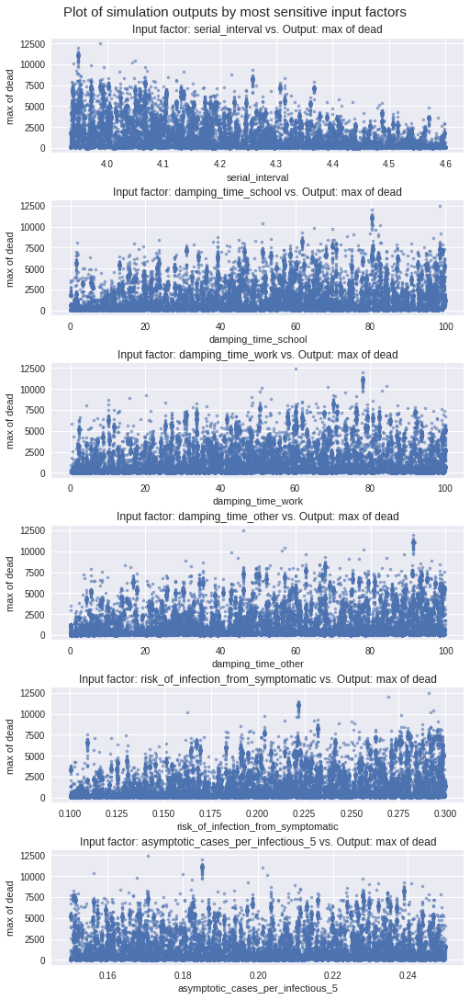

In [32]:
input_factor_list = ['serial_interval', 'damping_time_school', 'damping_time_work', 'damping_time_other', 'risk_of_infection_from_symptomatic', 'asymptotic_cases_per_infectious_5']

fig, axs = plt.subplots(nrows = len(input_factor_list), ncols = 1, figsize = (7, 15), constrained_layout=True)
fig.suptitle("Plot of simulation outputs by most sensitive input factors", fontsize = 15)

for i, input_factor in enumerate(input_factor_list): 
    axs[i].plot(study[input_factor], study['output'], '.', alpha = 0.6)
    axs[i].set_title(f"Input factor: {input_factor} vs. Output: {aggregation_function} "+ 
              f"of {compartments[static_params['output_index'][0]]}", fontsize = 12)

    axs[i].set(xlabel = input_factor, 
                  ylabel = f"{aggregation_function} of {compartments[static_params['output_index'][0]]}")
#plt.tight_layout()
plt.show()

In [ ]:
# interactive plots: 
# i) click on one point -> information gets displayed (e.g. index id)
# ii) click on one point -> same point gets marked in other plots

In [37]:
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
output_notebook()

Loading BokehJS ...

In [39]:
from bokeh.resources import INLINE
import bokeh.io
from bokeh import *
bokeh.io.output_notebook(INLINE)

Loading BokehJS ...

In [40]:
from bokeh.models import ColumnDataSource
from bokeh.layouts import gridplot

# create a column data source for the plots to share
source = ColumnDataSource(data=dict(x0=study['serial_interval'], x1=study['damping_time_school'], y=study['output'])) 

TOOLS = "box_select,lasso_select,help"

# create a new plot and add a renderer
left = figure(tools=TOOLS, width=300, height=300)
left.circle('x0', 'y', source=source)

# create another new plot and add a renderer
right = figure(tools=TOOLS, width=300, height=300)
right.circle('x1', 'y', source=source)

p = gridplot([[left, right]])

show(p)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
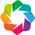

In [42]:
import numpy as np
import pandas as pd
import holoviews as hv

from holoviews.util.transform import dim
from holoviews.selection import link_selections
from holoviews.operation import gridmatrix
from holoviews.operation.element import histogram
from holoviews import opts

hv.extension('bokeh', 'plotly', width=100)

In [44]:
from bokeh.sampledata.autompg import autompg
autompg

,mpg,cyl,displ,hp,weight,accel,yr,origin,name
0,18.0,8,307.0,130,3504,12.0,70,1,chevrolet chevelle malibu
1,15.0,8,350.0,165,3693,11.5,70,1,buick skylark 320
2,18.0,8,318.0,150,3436,11.0,70,1,plymouth satellite
3,16.0,8,304.0,150,3433,12.0,70,1,amc rebel sst
4,17.0,8,302.0,140,3449,10.5,70,1,ford torino
...,...,...,...,...,...,...,...,...,...
387,27.0,4,140.0,86,2790,15.6,82,1,ford mustang gl
388,44.0,4,97.0,52,2130,24.6,82,2,vw pickup
389,32.0,4,135.0,84,2295,11.6,82,1,dodge rampage
390,28.0,4,120.0,79,2625,18.6,82,1,ford ranger


In [46]:
autompg_ds = hv.Dataset(autompg, ['yr', 'name', 'origin'])

mopts = opts.Points(size=2, tools=['box_select','lasso_select'], active_tools=['box_select'])

gridmatrix(autompg_ds, chart_type=hv.Points).opts(mopts)

:GridMatrix   [X,Y]
   :Histogram   [yr]   (yr_count)

In [47]:
colors = hv.Cycle('Category10').values
dims   = ["cyl", "displ", "hp", "mpg", "weight", "yr"]

layout = hv.Layout([
    hv.Points(autompg_ds, dims).opts(color=c)
    for c, dims in zip(colors, [[d,'accel'] for d in dims])
])

print(layout)

:Layout
   .Points.I   :Points   [cyl,accel]   (mpg,cyl,displ,hp,weight,accel)
   .Points.II  :Points   [displ,accel]   (mpg,cyl,displ,hp,weight,accel)
   .Points.III :Points   [hp,accel]   (mpg,cyl,displ,hp,weight,accel)
   .Points.IV  :Points   [mpg,accel]   (mpg,cyl,displ,hp,weight,accel)
   .Points.V   :Points   [weight,accel]   (mpg,cyl,displ,hp,weight,accel)
   .Points.VI  :Points   [yr,accel]   (mpg,cyl,displ,hp,weight,accel)


In [48]:
link_selections(layout).opts(opts.Points(width=200, height=200)).cols(6)

:Layout
   .Points.I   :DynamicMap   []
      :Overlay
         .Points.I     :Points   [cyl,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Points.II    :Points   [cyl,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Points.II  :DynamicMap   []
      :Overlay
         .Points.I     :Points   [displ,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Points.II    :Points   [displ,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Points.III :DynamicMap   []
      :Overlay
         .Points.I     :Points   [hp,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Points.II    :Points   [hp,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Points.IV  :DynamicMap   []
      :Overlay
         .Points.I     :Points   [mpg,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Points.II    :Points   [mpg,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Points.V   :DynamicMap   []
      :Overlay
         .Points.I     :Points   [weight,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Points.II    :Points   [weight,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Points.VI  :DynamicMap   []
      :Overlay
         .Points.I     :Points   [yr,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Points.II    :Points   [yr,accel]   (mpg,cyl,displ,hp,weight,accel)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]

In [53]:
list(zip(input_factor_list, input_factor_list))

[('serial_interval', 'serial_interval'),
 ('damping_time_school', 'damping_time_school'),
 ('damping_time_work', 'damping_time_work'),
 ('damping_time_other', 'damping_time_other'),
 ('risk_of_infection_from_symptomatic', 'risk_of_infection_from_symptomatic'),
 ('asymptotic_cases_per_infectious_5', 'asymptotic_cases_per_infectious_5')]

In [55]:
vdims = input_factor_list
ds = hv.Dataset(study, ['output'], vdims)


In [56]:
dims   = ['serial_interval', 'damping_time_school', 'damping_time_work', 'damping_time_other']

layout = hv.Layout([
    hv.Points(ds, dims).opts(color=c)
    for c, dims in zip(colors, [[d,'output'] for d in dims])
])

print(layout)

:Layout
   .Points.I   :Points   [serial_interval,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
   .Points.II  :Points   [damping_time_school,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
   .Points.III :Points   [damping_time_work,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
   .Points.IV  :Points   [damping_time_other,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)


In [60]:
link_selections(layout, selected_color='#ff0000', unselected_alpha=1, unselected_color='#90FF90').opts(opts.Points(width=400, height=400)).cols(4)

:Layout
   .Points.I   :DynamicMap   []
      :Overlay
         .Points.I     :Points   [serial_interval,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
         .Points.II    :Points   [serial_interval,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Points.II  :DynamicMap   []
      :Overlay
         .Points.I     :Points   [damping_time_school,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
         .Points.II    :Points   [damping_time_school,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Points.III :DynamicMap   []
      :Overlay
         .Points.I     :Points   [damping_time_work,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
         .Points.II    :Points   [damping_time_work,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]
   .Points.IV  :DynamicMap   []
      :Overlay
         .Points.I     :Points   [damping_time_other,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
         .Points.II    :Points   [damping_time_other,output]   (serial_interval,damping_time_school,damping_time_work,damping_time_other,risk_of_infection_from_symptomatic,asymptotic_cases_per_infectious_5)
         .Rectangles.I :Rectangles   [x0,y0,x1,y1]
         .Path.I       :Path   [x,y]

## Serial interval

In [7]:
with open('Studies/MC_serial_interval_10_100_Dead.pkl', 'rb') as f:
    N_outer = pickle.load(f)
    N_inner = pickle.load(f)
    input_factor_names = pickle.load(f)
    distributions = pickle.load(f)
    static_params = pickle.load(f)
    input_factor_i = pickle.load(f)
    dist_i = pickle.load(f)
    outs = pickle.load(f)
    
print(f"N_outer: {N_outer} ")
print(f"N_inner: {N_inner} ")
print(f"nb input_factor_names: {len(input_factor_names)} ")
print(f"input_factor_i: {input_factor_i} ")
print(f"distribution i: {dist_i} ")
print(f"Output indices: {static_params['output_index']} ")

N_outer: 10 
N_inner: 100 
nb input_factor_names: 79 
input_factor_i: serial_interval 
distribution i: Uniform(a = 0.63, b = 0.87) 
Output indices: [7] 


In [13]:
print(outs[0].shape)
print(np.array(outs).shape)

(100, 1)
(10, 100, 1)


In [19]:
ot.RandomGenerator.SetSeed(0)
ot.MonteCarloExperiment(dist_i, N_inner).generate()

class=Sample name=Uniform implementation=class=SampleImplementation name=Uniform size=100 dimension=1 description=[X0] data=[[0.78117],[0.841873],[0.662466],[0.637801],[0.713294],[0.862662],[0.850963],[0.75073],[0.645169],[0.700262],[0.801452],[0.722007],[0.719704],[0.806944],[0.842041],[0.700799],[0.852842],[0.826995],[0.794298],[0.828727],[0.716353],[0.859139],[0.771268],[0.673689],[0.650588],[0.788575],[0.680506],[0.722695],[0.635894],[0.73054],[0.865642],[0.849872],[0.859345],[0.743508],[0.692367],[0.788722],[0.747546],[0.742446],[0.656659],[0.712877],[0.787434],[0.792021],[0.864955],[0.78512],[0.645411],[0.815525],[0.868608],[0.649938],[0.683968],[0.702629],[0.682131],[0.78112],[0.769237],[0.742101],[0.797039],[0.807864],[0.854837],[0.839148],[0.724363],[0.78102],[0.849247],[0.849216],[0.668253],[0.760665],[0.678877],[0.835391],[0.734419],[0.716799],[0.630506],[0.687464],[0.691238],[0.771968],[0.670612],[0.86456],[0.745918],[0.800234],[0.859907],[0.798724],[0.826843],[0.745651],[0.679576],[0.810287],[0.852127],[0.782622],[0.774519],[0.798361],[0.64906],[0.69056],[0.792474],[0.716029],[0.730831],[0.707125],[0.821664],[0.768135],[0.708893],[0.863204],[0.754231],[0.655877],[0.847869],[0.809939]]

Outs: one row is one configuration of $X_{\sim i}$, $X_i$ is variied over its distribution *N_inner* times. 
This is repeated for *N_outer* different points of $X_{\sim i}$

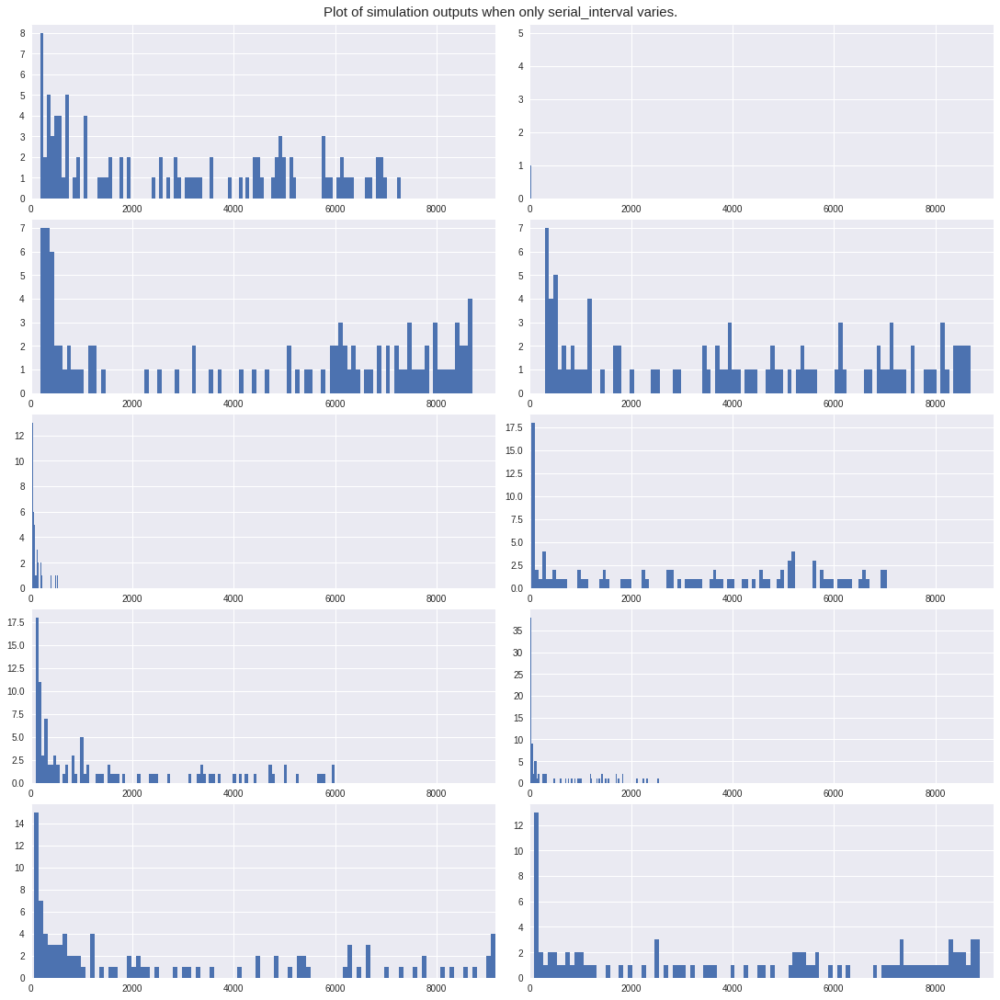

In [14]:
fig, axs = plt.subplots(nrows = 5, ncols = 2, figsize = (15, 15), constrained_layout=True)
fig.suptitle(f"Plot of simulation outputs when only {input_factor_i} varies.", fontsize = 15)

for i in range(5): 
    for j in range(2):
        axs[i, j].hist(outs[i + j*5], bins=100)
        axs[i, j].set_xlim([0, np.max(np.array(outs))])
        #axs[i, j].set_title(f"Input factor: {input_factor} vs. Output: {aggregation_function} "+ 
                  #f"of {compartments[static_params['output_index'][0]]}", fontsize = 12)

        #axs[i, j].set(xlabel = input_factor, 
                      #ylabel = f"{aggregation_function} of {compartments[static_params['output_index'][0]]}")
#plt.tight_layout()
plt.show()

In [48]:
from random import randint

In [ ]:
N_colors = sns.
N_colors = sns.diverging_palette(246.4, 33.3, s=23.5, l=62, n = N)
N_colors

In [103]:
N_colors = sns.color_palette("Set3", N)
N_colors

[(0.5529411764705883, 0.8274509803921568, 0.7803921568627451),
 (1.0, 1.0, 0.7019607843137254),
 (0.7450980392156863, 0.7294117647058823, 0.8549019607843137),
 (0.984313725490196, 0.5019607843137255, 0.4470588235294118),
 (0.5019607843137255, 0.6941176470588235, 0.8274509803921568),
 (0.9921568627450981, 0.7058823529411765, 0.3843137254901961),
 (0.7019607843137254, 0.8705882352941177, 0.4117647058823529),
 (0.9882352941176471, 0.803921568627451, 0.8980392156862745),
 (0.8509803921568627, 0.8509803921568627, 0.8509803921568627),
 (0.7372549019607844, 0.5019607843137255, 0.7411764705882353)]

In [33]:
np.array(outs).squeeze().shape

(10, 100)

In [28]:
N_colors = sns.blend_palette(colors=["#D9D7D7", "#A9A9A9", "#8897AE", "#DE8344"], n_colors=N_outer)
N_colors
aggregation_function = 'max'

In [71]:
sns.kdeplot( data = np.array(outs[0]), palette = N_colors, label = 'aaaa', log_scale = True, )


ValueError: The palette list has the wrong number of colors.

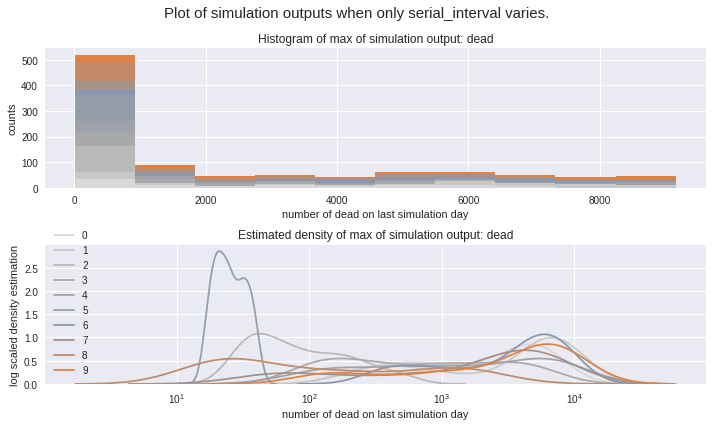

In [77]:
fig, axs = plt.subplots(nrows = 2, ncols = 1, figsize = (10, 6), tight_layout = True)
fig.suptitle(f"Plot of simulation outputs when only {input_factor_i} varies.", fontsize = 15)
s = np.array(outs).squeeze().transpose()#[outs[i] for i in range(N_outer)]

nbins = 10
n, bins, patches = axs[0].hist(s, bins=nbins, stacked = True)
for i in range(N_outer):
    sns.kdeplot(ax = axs[1], data = outs[i], legend = False, clip = [0, np.max(np.array(outs))], log_scale = True, 
               label=str(i))#N_colors[i])
    axs[1].lines[i].set_color(N_colors[i])
axs[0].set_title(f"Histogram of {aggregation_function} of simulation output: {compartments[static_params['output_index'][0]]}")
axs[1].set_title(f"Estimated density of {aggregation_function} of simulation output: {compartments[static_params['output_index'][0]]}")
axs[1].legend()
axs[0].set(xlabel = 'number of dead on last simulation day', ylabel = "counts")
axs[1].set(xlabel = 'number of dead on last simulation day', ylabel = "log scaled density estimation")

for i in range(N_outer):
    for j in range(nbins):
        patches[i].patches[j].set_facecolor(N_colors[i])

In [40]:
outs[0]

array([[ 177.08902498],
       [6599.15614254],
       [1326.79128905],
       [3283.19100583],
       [ 641.39889917],
       [ 335.68306309],
       [1546.79999645],
       [ 354.10656436],
       [ 268.85824911],
       [ 376.27820688],
       [3547.61006714],
       [1076.73352364],
       [4902.11755313],
       [3376.73325067],
       [2677.05697002],
       [6091.18067818],
       [ 955.84345673],
       [ 676.82425789],
       [3561.39244809],
       [6869.83284896],
       [2836.0602593 ],
       [6052.91051731],
       [4993.8320434 ],
       [5215.67079926],
       [4751.2971593 ],
       [1933.99530905],
       [ 192.25205473],
       [6827.69399466],
       [1953.17226928],
       [4810.21677627],
       [4891.3816637 ],
       [ 744.05866004],
       [5821.41534673],
       [2817.1732641 ],
       [7297.92516021],
       [ 188.01652707],
       [6913.78306308],
       [ 324.14961212],
       [1032.19449067],
       [4992.89782874],
       [2580.54276795],
       [ 868.116

In [44]:
print(outs[5].min(), outs[5].max())


16.77685045866071

In [53]:
patches[0]

<BarContainer object of 10 artists>

In [78]:
inputDistribution = ot.ComposedDistribution(distributions)
inputDistribution.setDescription(input_factor_names)
ot.MonteCarloExperiment(inputDistribution, N_outer).generate().asDataFrame().iloc[5, :40]

serial_interval                            4.349816
infectious_mild_time                       7.254210
hospitalized_to_ICU_time                   5.194288
risk_of_infection_from_symptomatic         0.235650
max_risk_of_infection_from_symptomatic     0.324161
damping_coeff_home                         0.257163
damping_coeff_school                       0.104059
damping_coeff_work                         0.096732
damping_coeff_other                        0.531922
damping_time_home                         51.340453
damping_time_school                       39.592492
damping_time_work                         48.637843
damping_time_other                        36.900034
hospitalized_to_home_time_0                4.953987
hospitalized_to_home_time_1                4.967097
hospitalized_to_home_time_2                5.115350
hospitalized_to_home_time_3                7.456340
hospitalized_to_home_time_4               10.740075
hospitalized_to_home_time_5               14.830211
home_to_hosp